In [1]:
import matplotlib.pyplot as plt
import numpy as np
import torch
from data import Data
from loss import Loss
from model import MobileViT, HFFH
from trainer import Trainer
from saved import Saver

In [2]:
print(torch.cuda.get_device_name(0))

args = {}

# model
args['model'] = "fftnet"
args['xyz_str'] = "xz"
args['device'] = torch.device("cuda:0")
args['act'] = "CRelu" #CTanh, CRelu
args['in_channels'] = 1
args['out_channels'] = 1
args['n_feats'] = 64
args['kernel_size'] = 5
args['res_scale'] = 0.8
args['n_res_blocks'] = 64
args['precision'] = "single"

# loss function
args['loss'] = "1*L1"  # loss functions separated by '+', each loss function has [weight]*[loss_type]

# trainer
args['optimizer'] = "ADAM"
args['lr'] = 1e-4
args['weight_decay'] = 0
args['decay'] = "10-20-30-50-75-100-150-200"   # Decay milestones
args['gamma'] = 0.5     # Decay factor at each milestone
args['betas'] = (0.9, 0.999)
args['epsilon'] = 1e-8
args['print_every'] = 0 # 0 = never
args['epochs'] = 1e8
args['batch_size'] = 512

NVIDIA GeForce RTX 3090


In [5]:
s = Saver()
args, m, l, t = s.Load(d, ComplexModel, Loss, Trainer, "./saved/fftnet5.tar")

Making FFT-Net model...
Making the trainer...
Loaded model from: ./saved/fftnet5.tar


In [4]:
m = MobileViT(args)
l = Loss(args)
t = Trainer(args, d, m, l)

Making FFT-Net model...
Preparing complex loss function...
	1.000 * L1
Making the trainer...


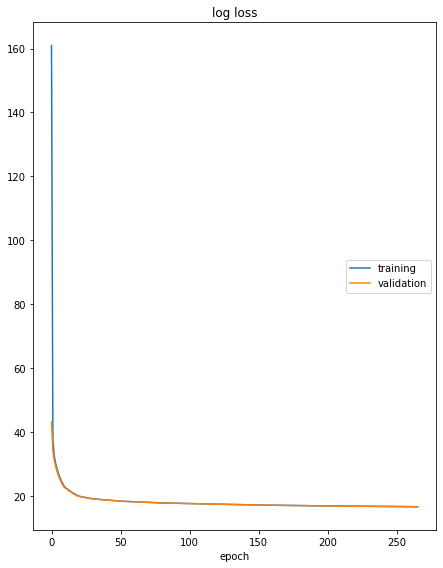

log loss
	training         	 (min:   16.652, max:  160.969, cur:   16.652)
	validation       	 (min:   16.646, max:   43.168, cur:   16.646)


KeyboardInterrupt: 

In [5]:
# train the model
while not t.terminate():
    t.train()

In [13]:
d.create_dataset_test(64, 2)

SNR = 8.375013000027515


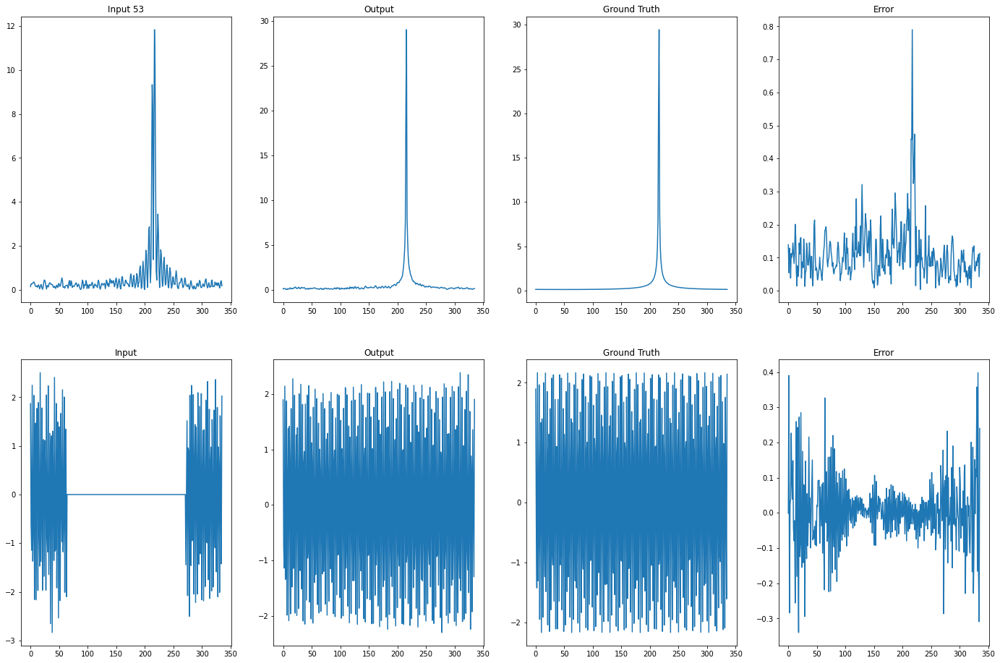

In [16]:
d.test_net(args, m, d)

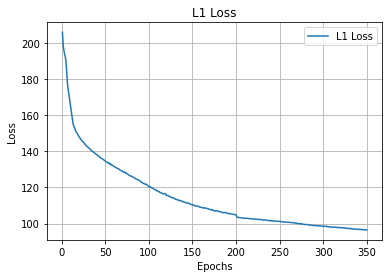

In [45]:
l.plot_loss("./", 350)

In [15]:
s = Saver()
s.Save(args, m, l, t, "./saved/sarnet2.tar")

Saved model to: ./saved/sarnet2.tar


In [17]:
from scipy.constants import c, pi

sar = DualRadarSAR(dr)

sar.create_array_1d(200, c / 79e9 / 8)

# resolution testing
dz = c/(2*16e9)
sar.create_target(np.array([[0, 0, 0.25],[0, 0, 0.25+dz]]))
# sar.create_target(np.array([0, 0, 0.25]))
# sar.create_target_rand_XZ(4, [0.2, 0.3])

x_m = np.linspace(-0.05, 0.05, 512)
z_m = np.linspace(0.2, 0.3, 512)

sar.Compute_LR()
sar.reconstruct_x_sar_xz_rma(512, 512, im_x=x_m, im_z=z_m, title="LR - Dual-Band")

In [18]:
sar.Compute_HR()
sar.reconstruct_x_sar_xz_rma(512, 512, im_x=x_m, im_z=z_m, title="HR - Full-Band")

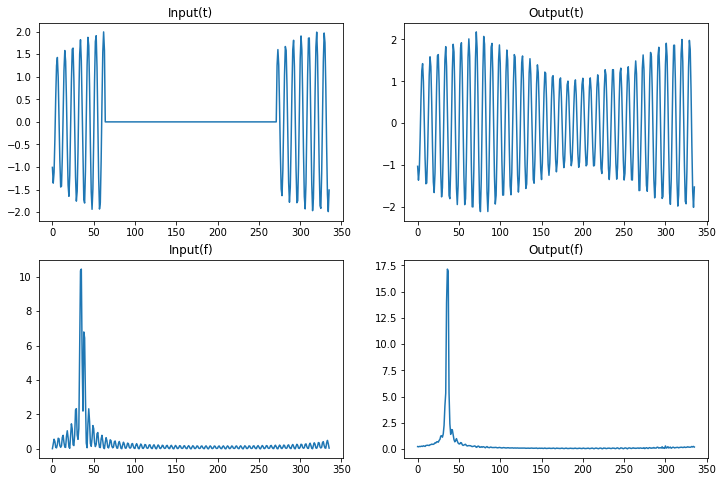

In [19]:
sar.test_model(args, m, 512, 512, im_x=x_m, im_z=z_m)

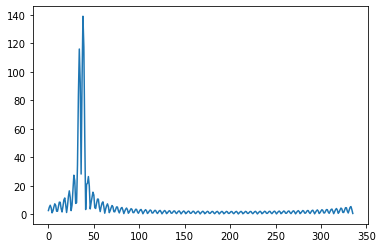

38


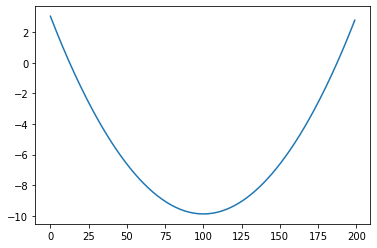

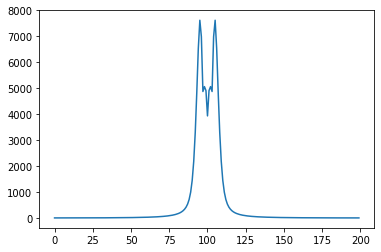

In [151]:
ran = np.fft.fft(sar.sar_data, axis=1)
ran.shape

plt.plot(np.abs(ran[32, :]))
plt.show()

x = np.argmax(np.abs(ran[32, :]))
print(x)

ang = np.unwrap(np.angle(ran[:, x]))

plt.plot(ang)
plt.show()

plt.plot(np.abs(np.fft.fftshift(np.fft.fft(ran[:, x]))))
plt.show()